In [4]:
import pandas as pd
import numpy as np
import warnings
import seaborn as sns
warnings.filterwarnings("ignore")
from sklearn.preprocessing import StandardScaler
import matplotlib.pyplot as plt
from sklearn import metrics


from imblearn.over_sampling import SMOTE
from sklearn.tree import DecisionTreeClassifier 
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import train_test_split

from sklearn.model_selection import GridSearchCV
from sklearn.model_selection import RandomizedSearchCV

from sklearn.linear_model import LogisticRegression
from sklearn.svm import SVC
from xgboost import XGBClassifier
from sklearn.model_selection import cross_val_score
from sklearn.ensemble import GradientBoostingClassifier


from imblearn.pipeline import make_pipeline as make_pipeline_imb 
from sklearn.pipeline import make_pipeline
from imblearn.metrics import classification_report_imbalanced
from sklearn.preprocessing import StandardScaler
from sklearn.preprocessing import LabelEncoder

import matplotlib as mpl
mpl.rcParams['agg.path.chunksize'] = 10000

from functions import getStatistics

ImportError: cannot import name 'getStatistics' from 'functions' (/home/einhard/mid-term_project/LHL_Midterm/EDA/functions.py)

In [3]:
flights = pd.read_csv('/media/einhard/Seagate Expansion Drive/lighthouse/midterm/data/random100000.csv', index_col=0)

data = flights
data = getStatistics(data)

CarrierEncoder = LabelEncoder()
CarrierEncoder.fit(data.op_unique_carrier)
data.op_unique_carrier = CarrierEncoder.transform(data.op_unique_carrier)
DupEncoder = LabelEncoder()
DupEncoder.fit(data.dup)
data.dup = DupEncoder.transform(data.dup)

data.fl_date = pd.to_datetime(data.fl_date)
data.cancellation_code = np.where(data.cancellation_code == 0, 0, 1)

NameError: name 'getStatistics' is not defined

In [9]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 100000 entries, 0 to 99999
Data columns (total 57 columns):
 #   Column                     Non-Null Count   Dtype         
---  ------                     --------------   -----         
 0   fl_date                    100000 non-null  datetime64[ns]
 1   origin_airport_id          100000 non-null  int64         
 2   dep_hr                     100000 non-null  int64         
 3   op_unique_carrier          100000 non-null  int64         
 4   mkt_unique_carrier         100000 non-null  object        
 5   branded_code_share         100000 non-null  object        
 6   mkt_carrier                100000 non-null  object        
 7   mkt_carrier_fl_num         100000 non-null  int64         
 8   tail_num                   99687 non-null   object        
 9   op_carrier_fl_num          100000 non-null  int64         
 10  origin                     100000 non-null  object        
 11  origin_city_name           100000 non-null  object   

In [33]:
data.dep_time

0        1404.0
1          21.0
2        1129.0
3        1655.0
4        1408.0
          ...  
99995    1238.0
99996    1851.0
99997    2301.0
99998     802.0
99999    2022.0
Name: dep_time, Length: 100000, dtype: float64

In [11]:
data.dtypes

fl_date                      datetime64[ns]
origin_airport_id                     int64
dep_hr                                int64
op_unique_carrier                     int64
mkt_unique_carrier                   object
branded_code_share                   object
mkt_carrier                          object
mkt_carrier_fl_num                    int64
tail_num                             object
op_carrier_fl_num                     int64
origin                               object
origin_city_name                     object
dest_airport_id                       int64
dest                                 object
dest_city_name                       object
crs_dep_time                          int64
dep_time                            float64
dep_delay                           float64
taxi_out                            float64
wheels_off                          float64
wheels_on                           float64
taxi_in                             float64
crs_arr_time                    

Text(0, 0.5, 'Arrival Time')

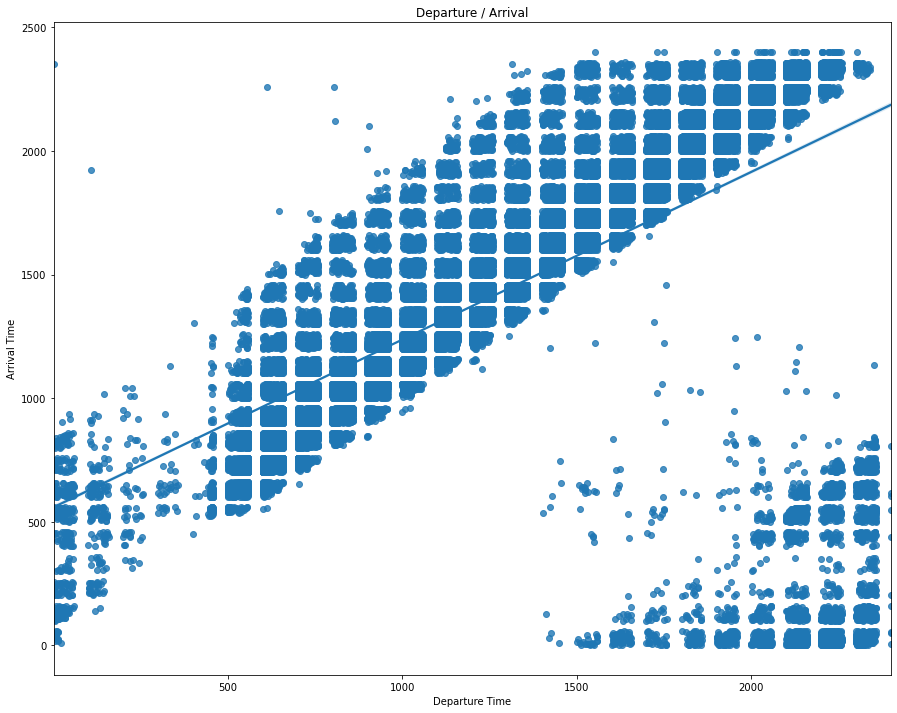

In [37]:
plt.figure(figsize=(15,12))
sns.regplot(data=data, x='dep_time', y='arr_time')
plt.title('Departure / Arrival')
plt.xlabel('Departure Time')
plt.ylabel('Arrival Time')

Text(0, 0.5, 'Arrival Time')

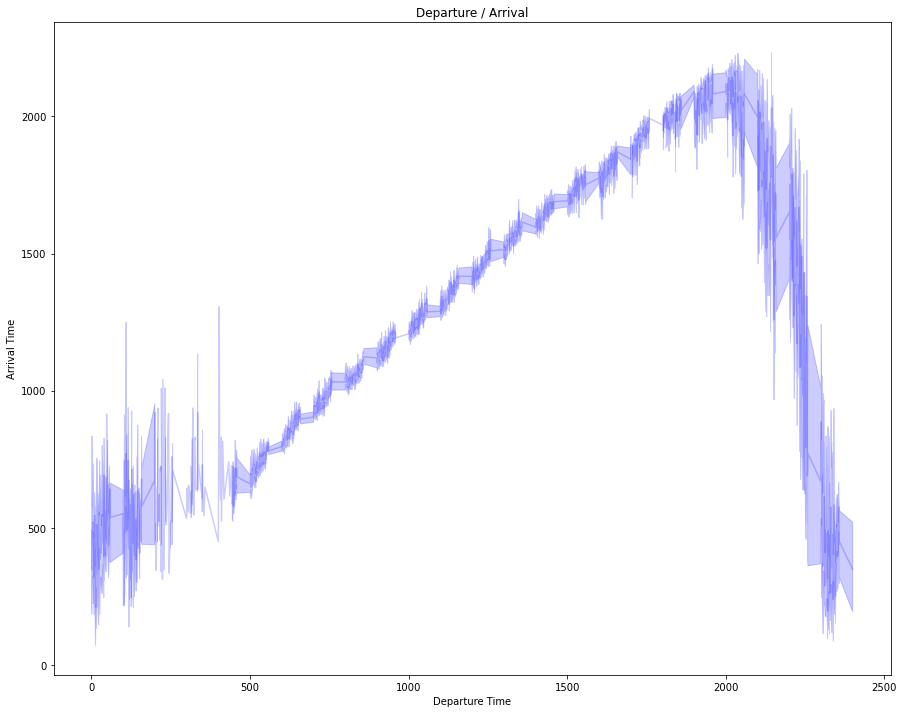

In [32]:
plt.figure(figsize=(15,12))
sns.lineplot(data['dep_time'], data['arr_time'], alpha=.2, color='blue', )
plt.title('Departure / Arrival')
plt.xlabel('Departure Time')
plt.ylabel('Arrival Time')

Text(0, 0.5, 'Late Aircraft Delay')

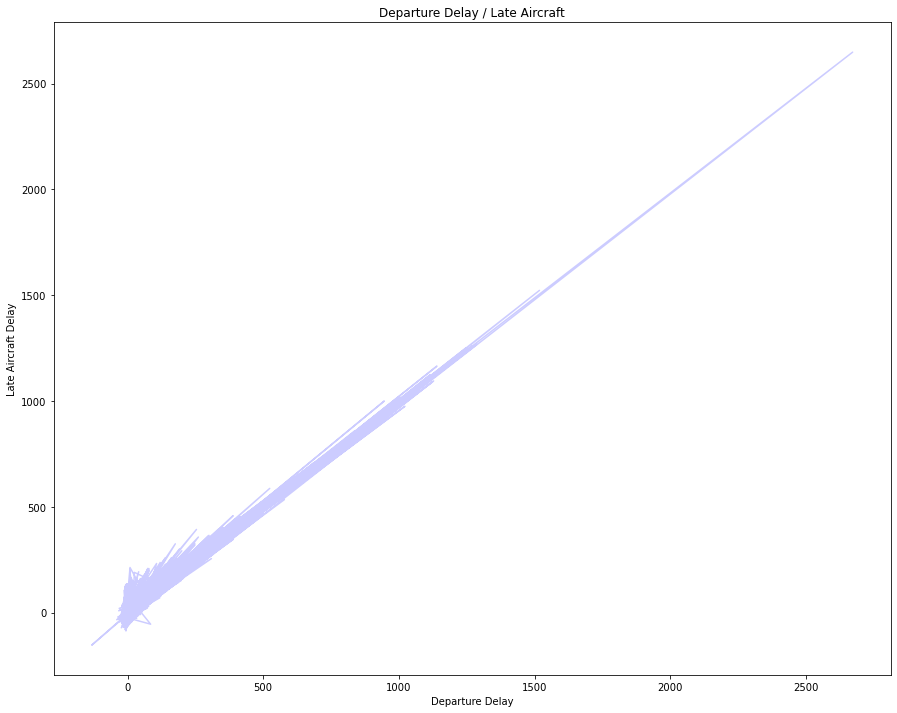

In [25]:
plt.figure(figsize=(15,12))
plt.plot(data['dep_delay'], data['arr_delay'], alpha=.2, color='blue', )
plt.title('Departure Delay / Arrival Delay')
plt.xlabel('Departure Delay')
plt.ylabel('Late Aircraft Delay')

Text(0, 0.5, 'Late Aircraft Delay')

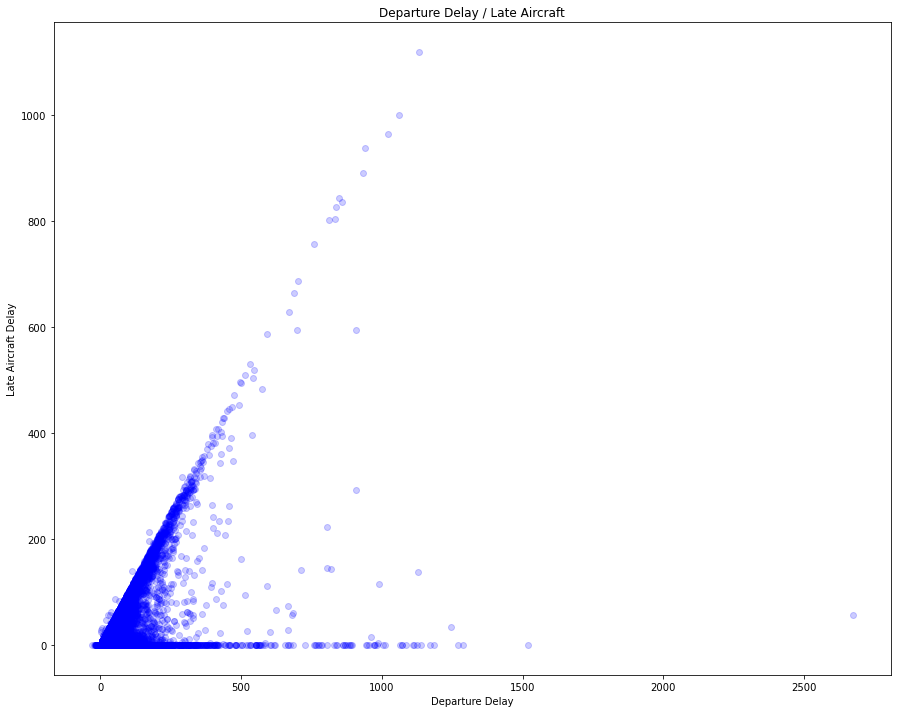

In [22]:
plt.figure(figsize=(15,12))
plt.scatter(data['dep_delay'], data['late_aircraft_delay'], alpha=.2, color='blue', )
plt.title('Departure Delay / Late Aircraft')
plt.xlabel('Departure Delay')
plt.ylabel('Late Aircraft Delay')

In [17]:
data.fl_date = pd.to_datetime(data.fl_date)
data['month'] = data.fl_date.dt.month
data['day'] = data.fl_date.dt.day
data['weekday'] = data.fl_date.dt.weekday

In [19]:
weekly_data = data.groupby('weekday').count().reset_index()


In [20]:
weekly_data

,weekday,fl_date,mkt_unique_carrier,branded_code_share,mkt_carrier,mkt_carrier_fl_num,op_unique_carrier,tail_num,op_carrier_fl_num,origin_airport_id,...,weather_delay,nas_delay,security_delay,late_aircraft_delay,first_dep_time,total_add_gtime,longest_add_gtime,no_name,month,day
0,0,15058,15058,15058,15058,15058,15058,15005,15058,15058,...,2983,2983,2983,2983,101,101,101,0,15058,15058
1,1,14349,14349,14349,14349,14349,14349,14302,14349,14349,...,2633,2633,2633,2633,105,105,105,0,14349,14349
2,2,14363,14363,14363,14363,14363,14363,14309,14363,14363,...,2520,2520,2520,2520,95,95,95,0,14363,14363
3,3,14841,14841,14841,14841,14841,14841,14798,14841,14841,...,3098,3098,3098,3098,91,91,91,0,14841,14841
4,4,15089,15089,15089,15089,15089,15089,15053,15089,15089,...,3178,3178,3178,3178,113,113,113,0,15089,15089
5,5,12232,12232,12232,12232,12232,12232,12199,12232,12232,...,1980,1980,1980,1980,82,82,82,0,12232,12232
6,6,14068,14068,14068,14068,14068,14068,14021,14068,14068,...,2605,2605,2605,2605,96,96,96,0,14068,14068


Text(0, 0.5, 'No of flights')

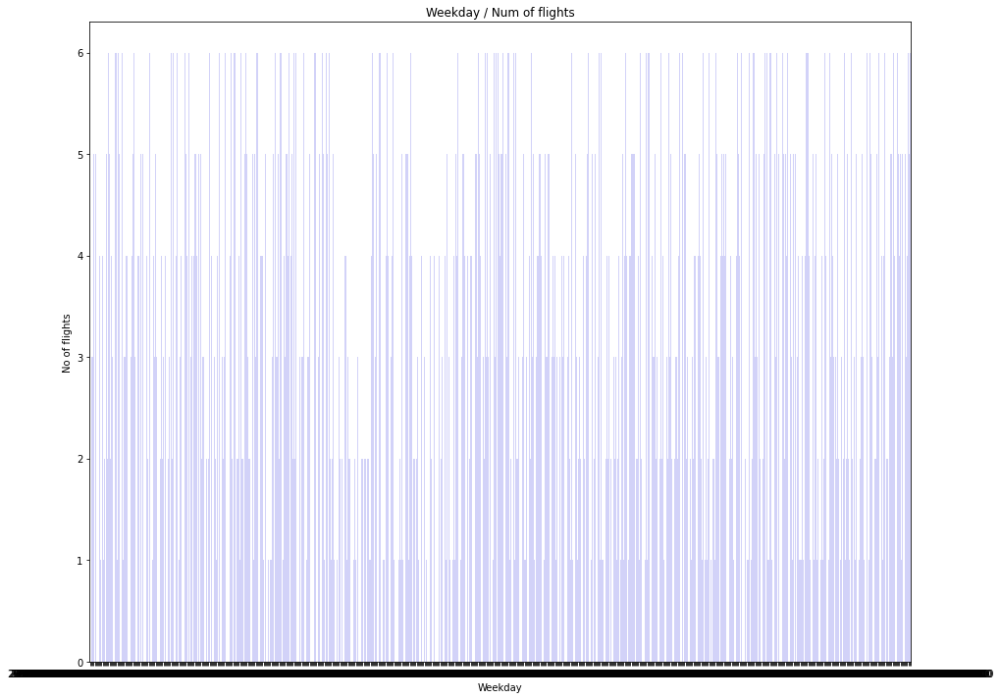